# Movies Exploratory Data Analysis

Using both dataprep.eda and matplotlib to create basic plots of our fields.

---------------

## For Matplotlib

After importing pandas, add this import line:

`import matplotlib.pyplot as plt`

- For documentation see: https://pandas.pydata.org/docs/user_guide/visualization.html
- To learn more about Matplotlib, see: https://matplotlib.org 


---------------

## For DataPrep.eda

**First install dataprep using the command prompt or terminal**

(Remember, if you are using an environment to install it within your environment.)

`pip install dataprep`

**Then add this import line:**

`from dataprep.eda import plot, plot_correlation`

For creating plots for exploratory data analysis, see the documentation here:
- https://docs.dataprep.ai/user_guide/eda/introduction.html

To learn more about the DataPrep.eda library:
- [Dataprep.eda: Accelerate your EDA](https://towardsdatascience.com/dataprep-eda-accelerate-your-eda-eb845a4088bc)
- [Exploratory Data Analysis: DataPrep.eda vs Pandas-Profiling](https://towardsdatascience.com/exploratory-data-analysis-dataprep-eda-vs-pandas-profiling-7137683fe47f)
- [DataPrep.eda Homepage - datapre.ai](https://dataprep.ai)

## Imports

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from dataprep.eda import plot, plot_correlation

Note: NumExpr detected 12 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
NumExpr defaulting to 8 threads.


## Read and Review Data

In [2]:
df = pd.read_pickle('output/movies_BUDG_REV.pkl.xz')
df

,title,release_date,budget,revenue,runtime,genre1,genres
14,The Birth of a Nation,1915-02-08,100000,11000000,193.0,Drama,"Drama, History, War"
28,Intolerance: Love's Struggle Throughout the Ages,1916-09-04,8394751,4000000,197.0,Drama,"Drama, History"
47,The Kid,1921-02-06,250000,2500000,68.0,Comedy,"Comedy, Drama"
57,Foolish Wives,1922-01-11,1100000,400200,143.0,Drama,Drama
78,The Thief of Bagdad,1924-03-18,1135654,1213880,149.0,Action,"Romance, Adventure, Fantasy"
...,...,...,...,...,...,...,...
26065,Star Wars: The Rise of Skywalker,2019-12-18,250000000,1058056021,142.0,Action,"Action, Adventure, Science Fiction"
26070,Cats,2019-12-19,95000000,71954915,110.0,Fantasy,"Comedy, Drama, Fantasy"
26074,The Fortune Goddess,2019-12-19,4000000,8277796,NaN,Drama,Drama
26092,Driving Licence,2019-12-20,704334,3803406,135.0,Action,"Drama, Thriller, Mystery, Action"


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5815 entries, 14 to 26121
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   title         5815 non-null   object        
 1   release_date  5815 non-null   datetime64[ns]
 2   budget        5815 non-null   int64         
 3   revenue       5815 non-null   int64         
 4   runtime       5810 non-null   float64       
 5   genre1        5814 non-null   category      
 6   genres        5814 non-null   object        
dtypes: category(1), datetime64[ns](1), float64(1), int64(2), object(2)
memory usage: 324.1+ KB


## Overview Distributions of All Fields


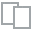
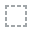
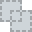
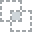
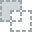
...
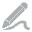
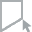
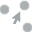
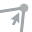
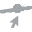

In [4]:
# Use dataprep.eda to plot all fields
plot(df)

## Time Series Analysis of `release_date`


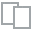
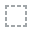
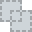
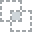
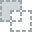
...
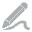
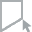
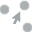
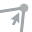
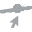

In [5]:
# dataprep.eda count of movies by date
plot(df, 'release_date')


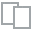
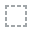
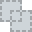
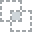
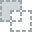
...
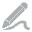
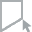
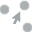
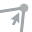
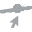

In [6]:
# dataprep AVG Budget by date
plot(df, 'release_date','budget')


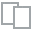
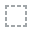
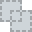
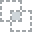
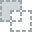
...
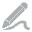
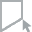
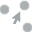
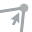
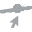

In [7]:
# Avg Revenue by date
plot(df, 'release_date','revenue')

## Univariate Analysis of Numeric Fields

### Univariate Analysis of `budget`

In [8]:
# Summary stats
df['budget'].describe().map('{:,.0f}'.format)

count          5,815
mean      32,164,621
std       41,114,852
min                1
25%        6,000,000
50%       18,000,000
75%       40,000,000
max      380,000,000
Name: budget, dtype: object


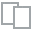
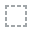
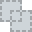
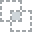
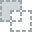
...
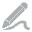
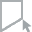
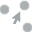
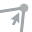
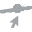

In [9]:
# dataprep.eda stats and charts
plot(df, 'budget')

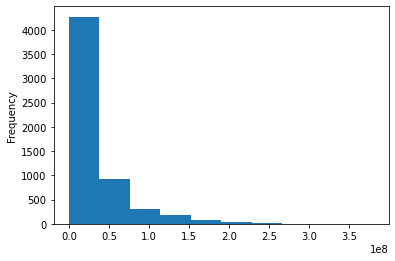

In [10]:
# Using matplotlib -- adding semicolon for cleaner chart
df['budget'].plot.hist();

**Evaluation:** Skewed to the right by a small number of very high budgets.

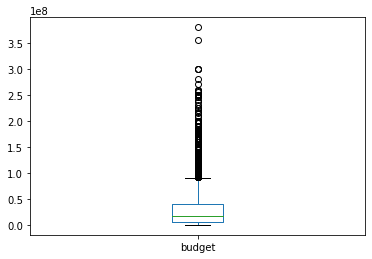

In [11]:
# matplotlib boxplot 
df['budget'].plot.box();

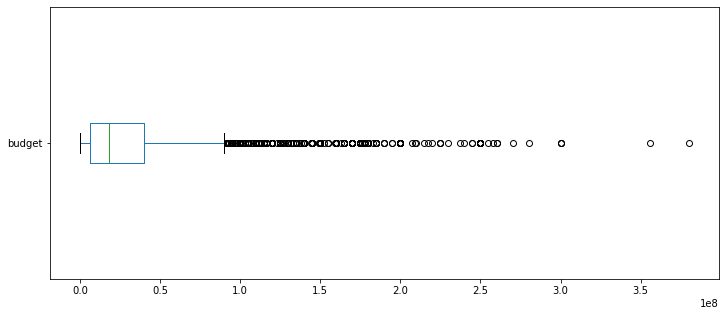

In [12]:
# matplotlib horizontal boxplot resized
df['budget'].plot.box(vert=False, figsize=(12,5));

**We have a *lot* of outliers with extraordinarily high budgets ...**

Let's do the math to see what number defines the upper whisker, beyond which movie budgets are considered outliers.

In [13]:
# Get the statistical summary
df['budget'].describe().map('{:,.0f}'.format)

count          5,815
mean      32,164,621
std       41,114,852
min                1
25%        6,000,000
50%       18,000,000
75%       40,000,000
max      380,000,000
Name: budget, dtype: object

**Outliers are those whose values are greater than 1.5 IQR above the 75th percentile.**
- IQR (interquartile range) = the range between the upper and lower quartile
- Lower Quartile = 6M
- Upper Quartile = 40M
- IQR = 40-6 = 34M
- 1.5 IQR = 51
- Upper whisker, bottom border of outliers = 40M + 51M = 91M

**Outliers are those with budget of $91M or greater**

### Univariate analysis of `revenue`


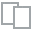
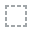
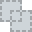
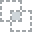
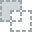
...
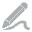
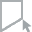
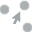
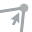
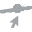

In [14]:
# Using dataprep.eda
plot(df, 'revenue')

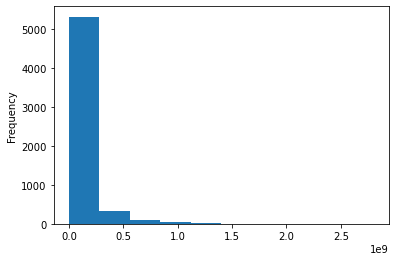

In [15]:
# Using matplotlib -- adding semicolon for cleaner chart
df['revenue'].plot.hist();

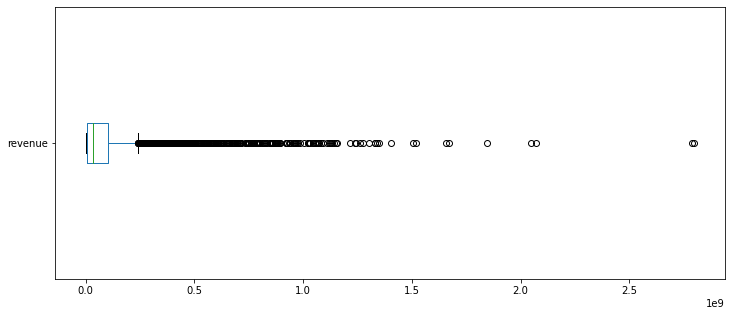

In [16]:
# matplotlib horizontal boxplot resized
df['revenue'].plot.box(vert=False, figsize=(12,5));

In [17]:
# Get the statistical summary
df['revenue'].describe().map('{:,.0f}'.format)

count            5,815
mean        95,661,997
std        179,892,596
min                  1
25%          8,599,919
50%         32,204,030
75%        102,332,635
max      2,797,800,564
Name: revenue, dtype: object

## Univariate Analysis of Categorical / Textual Fields

### Analysis of `genre`


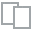
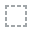
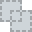
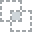
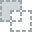
...
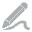
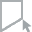
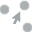
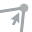
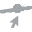

In [18]:
# dataprep overview
plot(df,'genre1')

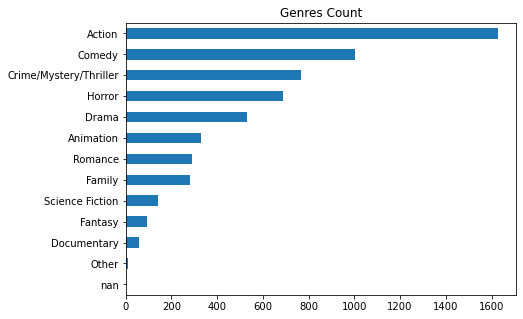

In [19]:
#  Matplotlib to get a horizontal bar chart, including null values
df['genre1'].value_counts(dropna=False).plot.barh(title = 'Genres Count', x='title', figsize=(7,5)).invert_yaxis()

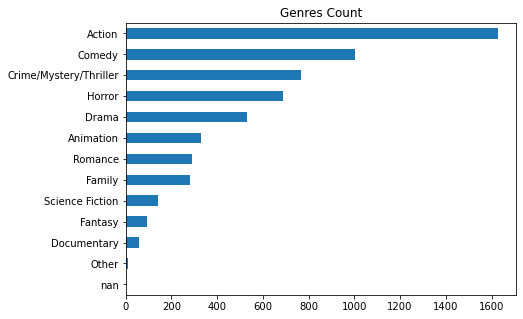

In [20]:
# Matplotlib to get a horizontal bar chart, including null values
# Multi-line for easier reading
(
df['genre1'].value_counts(dropna=False) # Get a count per category, including null values
            .plot.barh(title = 'Genres Count', x='title', figsize=(7,5))
            .invert_yaxis() # Fix sort order for horz bar chart
)

## Bivariate Analysis

### Budget and Revenue

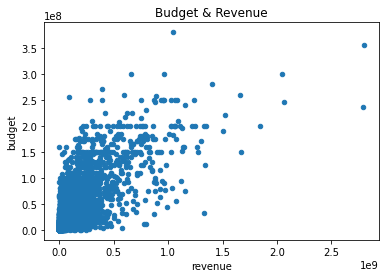

In [21]:
# matplotlib scatterplot
df.plot.scatter(title='Budget & Revenue', x='revenue', y='budget');


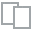
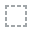
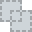
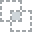
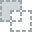
...
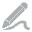
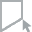
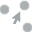
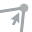
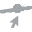

In [22]:
# dataprep version
# see plot_correlation doc page: https://docs.dataprep.ai/user_guide/eda/plot_correlation.html
plot_correlation(df, 'budget', 'revenue')

### Budget and Runtime


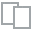
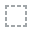
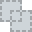
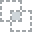
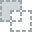
...
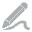
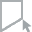
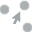
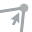
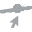

In [23]:
# dataprep
plot_correlation(df, 'runtime', 'budget')

### Revenue and Runtime


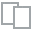
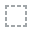
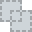
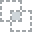
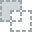
...
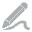
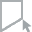
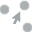
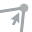
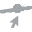

In [24]:
plot_correlation(df, 'runtime','revenue')

## Create Calculated Fields

**_and organize for more efficient analysis_**

1. Add `profit` and `ratio` columns
2. Rename `genre1` to `genre`
3. Reorder columns and drop `genres` column
4. Set `title` as the index

In [25]:
# View current dataframe
df

,title,release_date,budget,revenue,runtime,genre1,genres
14,The Birth of a Nation,1915-02-08,100000,11000000,193.0,Drama,"Drama, History, War"
28,Intolerance: Love's Struggle Throughout the Ages,1916-09-04,8394751,4000000,197.0,Drama,"Drama, History"
47,The Kid,1921-02-06,250000,2500000,68.0,Comedy,"Comedy, Drama"
57,Foolish Wives,1922-01-11,1100000,400200,143.0,Drama,Drama
78,The Thief of Bagdad,1924-03-18,1135654,1213880,149.0,Action,"Romance, Adventure, Fantasy"
...,...,...,...,...,...,...,...
26065,Star Wars: The Rise of Skywalker,2019-12-18,250000000,1058056021,142.0,Action,"Action, Adventure, Science Fiction"
26070,Cats,2019-12-19,95000000,71954915,110.0,Fantasy,"Comedy, Drama, Fantasy"
26074,The Fortune Goddess,2019-12-19,4000000,8277796,NaN,Drama,Drama
26092,Driving Licence,2019-12-20,704334,3803406,135.0,Action,"Drama, Thriller, Mystery, Action"


### Create `profit` Column

In [26]:
df['profit'] = df['revenue'] - df['budget']
df

,title,release_date,budget,revenue,runtime,genre1,genres,profit
14,The Birth of a Nation,1915-02-08,100000,11000000,193.0,Drama,"Drama, History, War",10900000
28,Intolerance: Love's Struggle Throughout the Ages,1916-09-04,8394751,4000000,197.0,Drama,"Drama, History",-4394751
47,The Kid,1921-02-06,250000,2500000,68.0,Comedy,"Comedy, Drama",2250000
57,Foolish Wives,1922-01-11,1100000,400200,143.0,Drama,Drama,-699800
78,The Thief of Bagdad,1924-03-18,1135654,1213880,149.0,Action,"Romance, Adventure, Fantasy",78226
...,...,...,...,...,...,...,...,...
26065,Star Wars: The Rise of Skywalker,2019-12-18,250000000,1058056021,142.0,Action,"Action, Adventure, Science Fiction",808056021
26070,Cats,2019-12-19,95000000,71954915,110.0,Fantasy,"Comedy, Drama, Fantasy",-23045085
26074,The Fortune Goddess,2019-12-19,4000000,8277796,NaN,Drama,Drama,4277796
26092,Driving Licence,2019-12-20,704334,3803406,135.0,Action,"Drama, Thriller, Mystery, Action",3099072


### Create `ratio` column

In [27]:
df['ratio'] = (df['revenue'] / df['budget'])
df

,title,release_date,budget,revenue,runtime,genre1,genres,profit,ratio
14,The Birth of a Nation,1915-02-08,100000,11000000,193.0,Drama,"Drama, History, War",10900000,110.000000
28,Intolerance: Love's Struggle Throughout the Ages,1916-09-04,8394751,4000000,197.0,Drama,"Drama, History",-4394751,0.476488
47,The Kid,1921-02-06,250000,2500000,68.0,Comedy,"Comedy, Drama",2250000,10.000000
57,Foolish Wives,1922-01-11,1100000,400200,143.0,Drama,Drama,-699800,0.363818
78,The Thief of Bagdad,1924-03-18,1135654,1213880,149.0,Action,"Romance, Adventure, Fantasy",78226,1.068882
...,...,...,...,...,...,...,...,...,...
26065,Star Wars: The Rise of Skywalker,2019-12-18,250000000,1058056021,142.0,Action,"Action, Adventure, Science Fiction",808056021,4.232224
26070,Cats,2019-12-19,95000000,71954915,110.0,Fantasy,"Comedy, Drama, Fantasy",-23045085,0.757420
26074,The Fortune Goddess,2019-12-19,4000000,8277796,NaN,Drama,Drama,4277796,2.069449
26092,Driving Licence,2019-12-20,704334,3803406,135.0,Action,"Drama, Thriller, Mystery, Action",3099072,5.400003


In [28]:
# Round to 2 decimals
df['ratio'] = (df['revenue'] / df['budget']).round(2)
df

,title,release_date,budget,revenue,runtime,genre1,genres,profit,ratio
14,The Birth of a Nation,1915-02-08,100000,11000000,193.0,Drama,"Drama, History, War",10900000,110.00
28,Intolerance: Love's Struggle Throughout the Ages,1916-09-04,8394751,4000000,197.0,Drama,"Drama, History",-4394751,0.48
47,The Kid,1921-02-06,250000,2500000,68.0,Comedy,"Comedy, Drama",2250000,10.00
57,Foolish Wives,1922-01-11,1100000,400200,143.0,Drama,Drama,-699800,0.36
78,The Thief of Bagdad,1924-03-18,1135654,1213880,149.0,Action,"Romance, Adventure, Fantasy",78226,1.07
...,...,...,...,...,...,...,...,...,...
26065,Star Wars: The Rise of Skywalker,2019-12-18,250000000,1058056021,142.0,Action,"Action, Adventure, Science Fiction",808056021,4.23
26070,Cats,2019-12-19,95000000,71954915,110.0,Fantasy,"Comedy, Drama, Fantasy",-23045085,0.76
26074,The Fortune Goddess,2019-12-19,4000000,8277796,NaN,Drama,Drama,4277796,2.07
26092,Driving Licence,2019-12-20,704334,3803406,135.0,Action,"Drama, Thriller, Mystery, Action",3099072,5.40


### Rename `genre1` to `genre` (singular) and drop `genres`

In [29]:
df.rename(columns = {'genre1':'genre'}, inplace = True)
df

,title,release_date,budget,revenue,runtime,genre,genres,profit,ratio
14,The Birth of a Nation,1915-02-08,100000,11000000,193.0,Drama,"Drama, History, War",10900000,110.00
28,Intolerance: Love's Struggle Throughout the Ages,1916-09-04,8394751,4000000,197.0,Drama,"Drama, History",-4394751,0.48
47,The Kid,1921-02-06,250000,2500000,68.0,Comedy,"Comedy, Drama",2250000,10.00
57,Foolish Wives,1922-01-11,1100000,400200,143.0,Drama,Drama,-699800,0.36
78,The Thief of Bagdad,1924-03-18,1135654,1213880,149.0,Action,"Romance, Adventure, Fantasy",78226,1.07
...,...,...,...,...,...,...,...,...,...
26065,Star Wars: The Rise of Skywalker,2019-12-18,250000000,1058056021,142.0,Action,"Action, Adventure, Science Fiction",808056021,4.23
26070,Cats,2019-12-19,95000000,71954915,110.0,Fantasy,"Comedy, Drama, Fantasy",-23045085,0.76
26074,The Fortune Goddess,2019-12-19,4000000,8277796,NaN,Drama,Drama,4277796,2.07
26092,Driving Licence,2019-12-20,704334,3803406,135.0,Action,"Drama, Thriller, Mystery, Action",3099072,5.40


In [30]:
df.drop(columns='genres', inplace=True)
df

,title,release_date,budget,revenue,runtime,genre,profit,ratio
14,The Birth of a Nation,1915-02-08,100000,11000000,193.0,Drama,10900000,110.00
28,Intolerance: Love's Struggle Throughout the Ages,1916-09-04,8394751,4000000,197.0,Drama,-4394751,0.48
47,The Kid,1921-02-06,250000,2500000,68.0,Comedy,2250000,10.00
57,Foolish Wives,1922-01-11,1100000,400200,143.0,Drama,-699800,0.36
78,The Thief of Bagdad,1924-03-18,1135654,1213880,149.0,Action,78226,1.07
...,...,...,...,...,...,...,...,...
26065,Star Wars: The Rise of Skywalker,2019-12-18,250000000,1058056021,142.0,Action,808056021,4.23
26070,Cats,2019-12-19,95000000,71954915,110.0,Fantasy,-23045085,0.76
26074,The Fortune Goddess,2019-12-19,4000000,8277796,NaN,Drama,4277796,2.07
26092,Driving Licence,2019-12-20,704334,3803406,135.0,Action,3099072,5.40


### Reorganize Columns

In [32]:
# Get list of current columns
list(df.columns)

['title',
 'release_date',
 'budget',
 'revenue',
 'runtime',
 'genre',
 'profit',
 'ratio']

In [33]:
# Move profit and ratio before runtime
df = df[[
 'title',
 'release_date',
 'budget',
 'revenue',
 'profit',
 'ratio',
 'runtime',
 'genre']]
df

,title,release_date,budget,revenue,profit,ratio,runtime,genre
14,The Birth of a Nation,1915-02-08,100000,11000000,10900000,110.00,193.0,Drama
28,Intolerance: Love's Struggle Throughout the Ages,1916-09-04,8394751,4000000,-4394751,0.48,197.0,Drama
47,The Kid,1921-02-06,250000,2500000,2250000,10.00,68.0,Comedy
57,Foolish Wives,1922-01-11,1100000,400200,-699800,0.36,143.0,Drama
78,The Thief of Bagdad,1924-03-18,1135654,1213880,78226,1.07,149.0,Action
...,...,...,...,...,...,...,...,...
26065,Star Wars: The Rise of Skywalker,2019-12-18,250000000,1058056021,808056021,4.23,142.0,Action
26070,Cats,2019-12-19,95000000,71954915,-23045085,0.76,110.0,Fantasy
26074,The Fortune Goddess,2019-12-19,4000000,8277796,4277796,2.07,NaN,Drama
26092,Driving Licence,2019-12-20,704334,3803406,3099072,5.40,135.0,Action


## Set `title` as the dataframe index

In [ ]:
df.set_index('title', inplace=True)
df

## EDA for Calculated Fields

### Univariate Analysis of `profit`

In [ ]:
# dataprep.eda stats and plots
plot(df, 'profit')

In [ ]:
# Get the statistical summary
df['profit'].describe().map('{:,.0f}'.format)

### Univariate Analysis of `ratio`

In [ ]:
# dataprep.eda stats and plots
plot(df, 'ratio')

In [ ]:
# matplotlib horizontal boxplot resized
df['ratio'].plot.box(vert=False, figsize=(12,5));

#### Interpretation and Questions
- The range of outliers is even more extreme than for budget, ratio, or profit.
- The outliers may need more investigation.

## Investigate Ratios (Revenue/Budget)

### Dollar-related fields sorted by highest ratio

In [ ]:
# Define a list of desired fields
cols = ['budget','revenue','profit','ratio']

# View the top 20 movies sorted by ratio
df[cols].sort_values('ratio', ascending=False).head(20)

In [ ]:
# Format the numbers for easier reading
cols = ['budget','revenue','profit','ratio']

# Wrap in parens to keep multiple lines together
(
df[cols].sort_values('ratio', ascending=False)
        .head(20)
        .apply(lambda s: s.apply('{:,.0f}'.format))
)

**Evaluation**
- Some of the budgets for these biggest outliers are ridiculously low.
- Let's find a lower-end cut-off for budgets and filter our data accordingly.

**Filter for movies with budgets GTE $50K**

In [35]:
# Filter for movies with budgets GTE $50K
df_budg50k = df[df['budget'] >= 50000]
df_budg50k.sort_values('budget')

,title,release_date,budget,revenue,profit,ratio,runtime,genre
25383,K-12,2019-09-05,50000,359377,309377,7.19,92.0,Horror
8485,The Isle,2000-04-22,50000,21075,-28925,0.42,90.0,Crime/Mystery/Thriller
12644,The Signal,2008-02-22,50000,249905,199905,5.00,103.0,Horror
7824,Pi,1998-07-10,60000,3221152,3161152,53.69,84.0,Crime/Mystery/Thriller
16942,Stockholm,2013-04-25,60000,50000,-10000,0.83,90.0,Romance
...,...,...,...,...,...,...,...,...
22672,Justice League,2017-11-15,300000000,657924295,357924295,2.19,120.0,Action
23270,Avengers: Infinity War,2018-04-25,300000000,2046239637,1746239637,6.82,149.0,Action
12060,Pirates of the Caribbean: At World's End,2007-05-19,300000000,961000000,661000000,3.20,169.0,Action
24733,Avengers: Endgame,2019-04-24,356000000,2797800564,2441800564,7.86,181.0,Action


In [ ]:
# View $50K+ sorted by ratio
cols = ['budget','revenue','profit','ratio']
# Wrap in parens to keep multiple lines together
(
df_budg50k[cols].sort_values('ratio', ascending=False)
        .head(20)
        .apply(lambda s: s.apply('{:,.0f}'.format))
)

#### Get summary stats for this filtered set of movies with budgets gte $100K


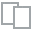
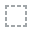
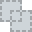
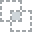
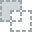
...
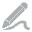
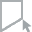
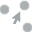
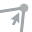
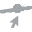

In [36]:
# dataprep.eda stats and plots
plot(df_budg50k, 'ratio')

## Charts

### Avg Ratio by Genre


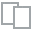
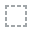
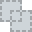
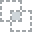
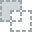
...
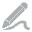
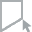
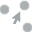
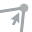
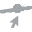

In [42]:
plot(df_budg50k, 'ratio', 'genre')

In [44]:
df['ratio'].mean()

437.9971728288912

In [43]:
df_budg50k['ratio'].mean()

5.697168433860594

In [47]:
df['ratio'].median()

2.1

In [46]:
df_budg50k['ratio'].median()

2.1

## Bivariate Analysis with Calculated Fields

### Budget and Ratio

In [ ]:
# dataprep correlation plot
plot_correlation(df, 'budget','ratio')

In [ ]:
# Movies with 100K+ budgets
# dataprep correlation plot
plot_correlation(df_budg100k, 'budget','ratio')

In [ ]:
# Movies with 1M+ budgets
# dataprep correlation plot
plot_correlation(df_budg1m, 'budget','ratio')

### ratio and profit

In [ ]:
# Movies with 1M+ budgets
# dataprep correlation plot
plot_correlation(df_budg1m, 'profit','ratio')

## Compare and Contrast Budgets GTE $40M

In [ ]:
df['budget'].describe().map('{:,.0f}'.format)

40M is the 75th percentile.

Filter for movies gte 40M

In [ ]:
df_budg40m = df[df['budget'] >= 40000000]
df_budg40m.sort_values('budget')

In [ ]:
df_budg40m.sort_values('budget', ascending=False).head(20)

In [ ]:
plot(df_budg40m)

## Compare and Contrast Budgets GTE $91M

These are the outliers for budget: `40M + 1.5 * 34M = 91M`



Filter for movies gte 91M

In [ ]:
df_budg91m = df[df['budget'] >= 91000000]
df_budg91m.sort_values('budget')

In [ ]:
df_budg91m.sort_values('budget').head(20)

In [ ]:
plot(df_budg91m)

## Plot ratio over time

In [ ]:
# For main dataframe
plot(df, 'release_date', 'ratio')

In [ ]:
# For filtered dataframes
# 50k
plot(df_budg50k, 'release_date', 'ratio')

In [ ]:
# For filtered dataframes
# 500k
plot(df_budg500k, 'release_date', 'ratio')

In [ ]:
# For filtered dataframes
# 1m
plot(df_budg1m, 'release_date', 'ratio')

In [ ]:
# For filtered dataframes
# 40m
plot(df_budg40m, 'release_date', 'ratio')

In [ ]:
# For filtered dataframes
# 91m
plot(df_budg91m, 'release_date', 'ratio')